# New York City Airbnb Open Data

## Imports

In [13]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
import folium
import sklearn

## Load the Data
Since 2008, guests and hosts have used Airbnb to expand on traveling possibilities and present more unique, personalized way of experiencing the world. This dataset describes the listing activity and metrics in NYC, NY for 2019.

In [14]:
data_path = "data/AB_NYC_2019.csv"

In [15]:
df = pd.read_csv(data_path, index_col=0)

In [16]:
print("Observations:", df.shape[0])
print("Features:", df.shape[1])

Observations: 48895
Features: 15


## Data Exploration

In [17]:
# get a feeling how the data looks like
df.head()

,name,host_id,host_name,neighbourhood_group,neighbourhood,latitude,longitude,room_type,price,minimum_nights,number_of_reviews,last_review,reviews_per_month,calculated_host_listings_count,availability_365
id,,,,,,,,,,,,,,,
2539,Clean & quiet apt home by the park,2787,John,Brooklyn,Kensington,40.64749,-73.97237,Private room,149,1,9,2018-10-19,0.21,6,365
2595,Skylit Midtown Castle,2845,Jennifer,Manhattan,Midtown,40.75362,-73.98377,Entire home/apt,225,1,45,2019-05-21,0.38,2,355
3647,THE VILLAGE OF HARLEM....NEW YORK !,4632,Elisabeth,Manhattan,Harlem,40.80902,-73.94190,Private room,150,3,0,NaN,NaN,1,365
3831,Cozy Entire Floor of Brownstone,4869,LisaRoxanne,Brooklyn,Clinton Hill,40.68514,-73.95976,Entire home/apt,89,1,270,2019-07-05,4.64,1,194
5022,Entire Apt: Spacious Studio/Loft by central park,7192,Laura,Manhattan,East Harlem,40.79851,-73.94399,Entire home/apt,80,10,9,2018-11-19,0.10,1,0


In [6]:
# check data types: Numerical vs categorical
df.dtypes

name                               object
host_id                             int64
host_name                          object
neighbourhood_group                object
neighbourhood                      object
latitude                          float64
longitude                         float64
room_type                          object
price                               int64
minimum_nights                      int64
number_of_reviews                   int64
last_review                        object
reviews_per_month                 float64
calculated_host_listings_count      int64
availability_365                    int64
dtype: object

In [7]:
# get summary statistics of the numerical variables
df.describe()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
count,4.889500e+04,48895.000000,48895.000000,48895.000000,48895.000000,48895.000000,38843.000000,48895.000000,48895.000000
mean,6.762001e+07,40.728949,-73.952170,152.720687,7.029962,23.274466,1.373221,7.143982,112.781327
std,7.861097e+07,0.054530,0.046157,240.154170,20.510550,44.550582,1.680442,32.952519,131.622289
min,2.438000e+03,40.499790,-74.244420,0.000000,1.000000,0.000000,0.010000,1.000000,0.000000
25%,7.822033e+06,40.690100,-73.983070,69.000000,1.000000,1.000000,0.190000,1.000000,0.000000
50%,3.079382e+07,40.723070,-73.955680,106.000000,3.000000,5.000000,0.720000,1.000000,45.000000
75%,1.074344e+08,40.763115,-73.936275,175.000000,5.000000,24.000000,2.020000,2.000000,227.000000
max,2.743213e+08,40.913060,-73.712990,10000.000000,1250.000000,629.000000,58.500000,327.000000,365.000000


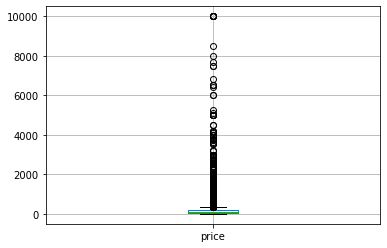

In [8]:
df.boxplot(column=["price"])

TypeError: can only concatenate str (not "int") to str

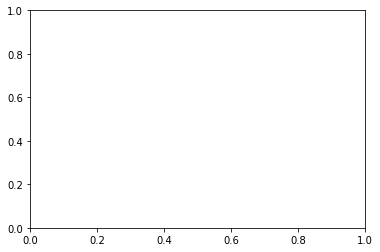

In [12]:
sns.distplot(df)

Histograms


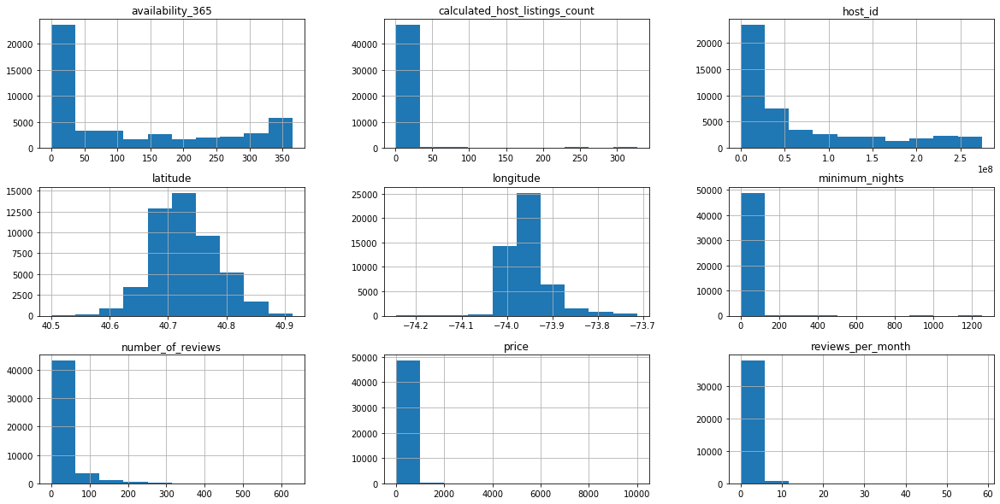

In [9]:
# check distribution of the features
df.hist(figsize=(20,10))

print("Histograms")

In [10]:
# check missing values
df.isna().sum()

name                                 16
host_id                               0
host_name                            21
neighbourhood_group                   0
neighbourhood                         0
latitude                              0
longitude                             0
room_type                             0
price                                 0
minimum_nights                        0
number_of_reviews                     0
last_review                       10052
reviews_per_month                 10052
calculated_host_listings_count        0
availability_365                      0
dtype: int64

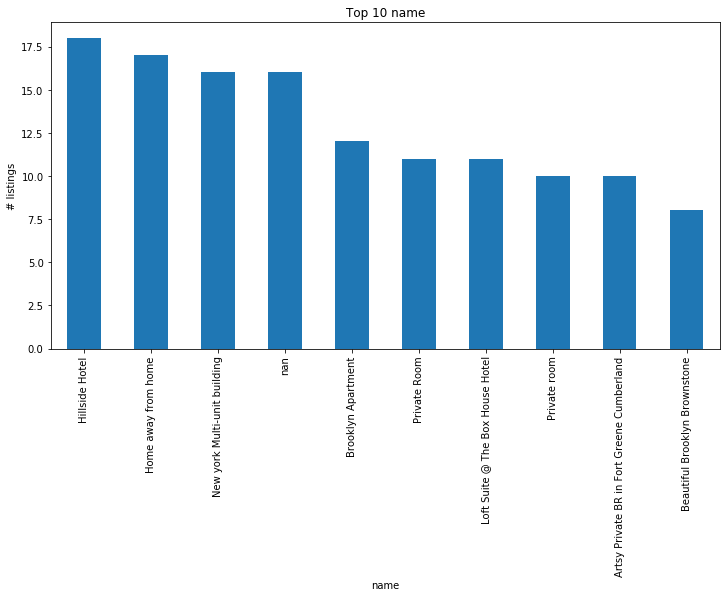

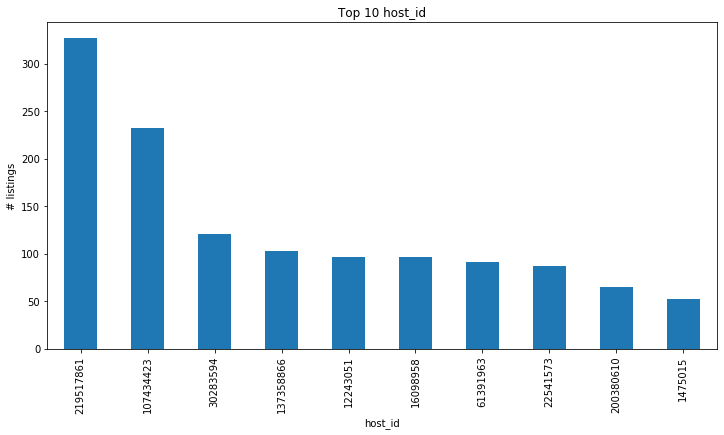

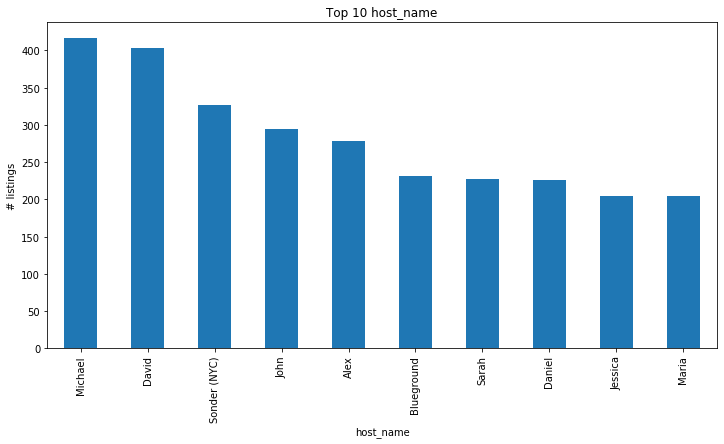

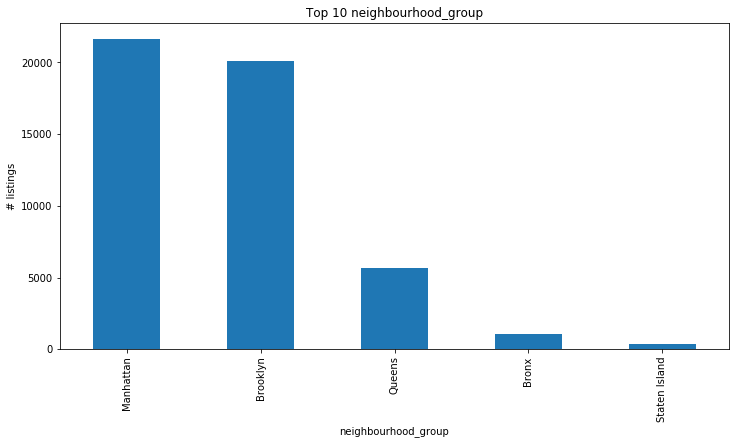

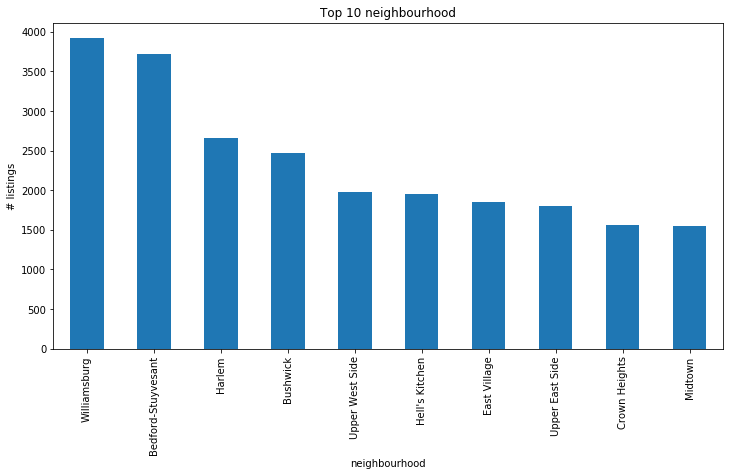

...

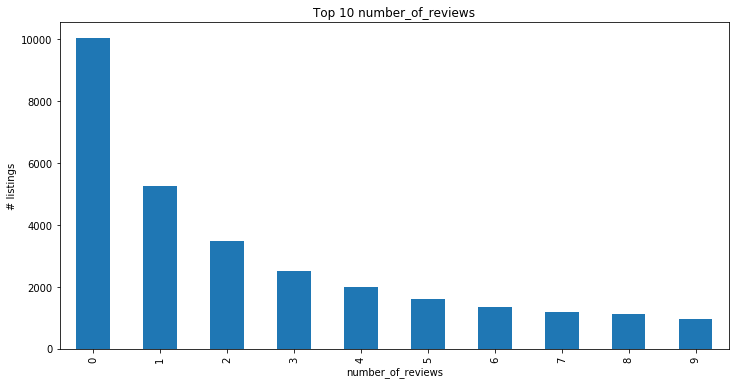

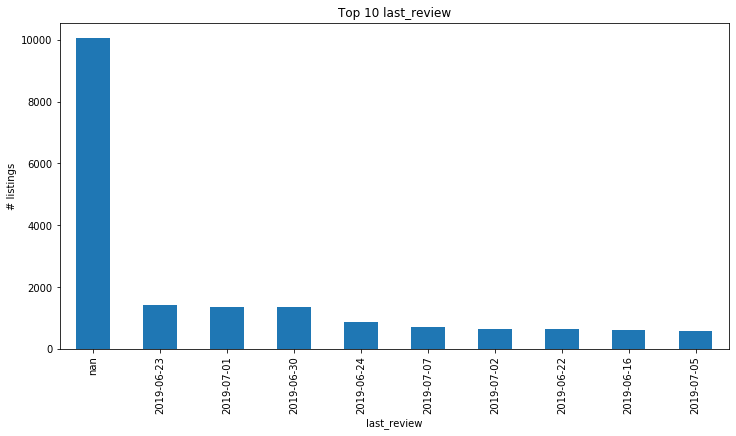

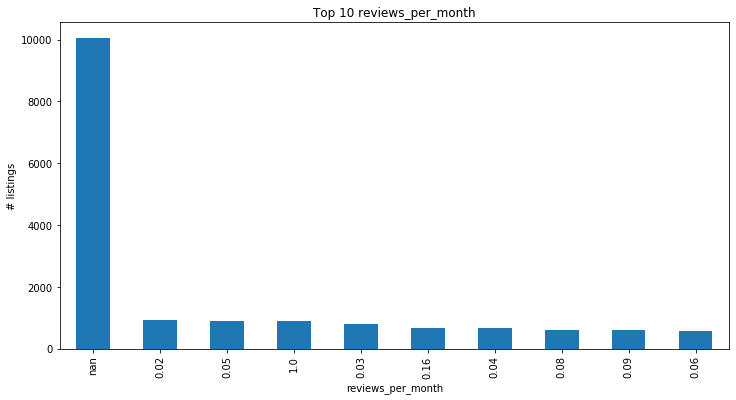

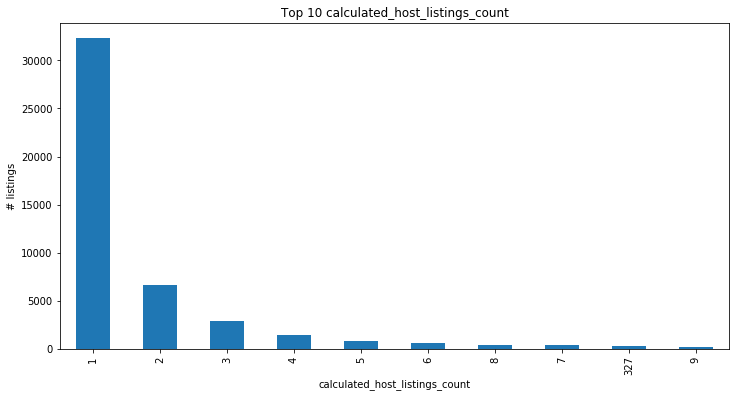

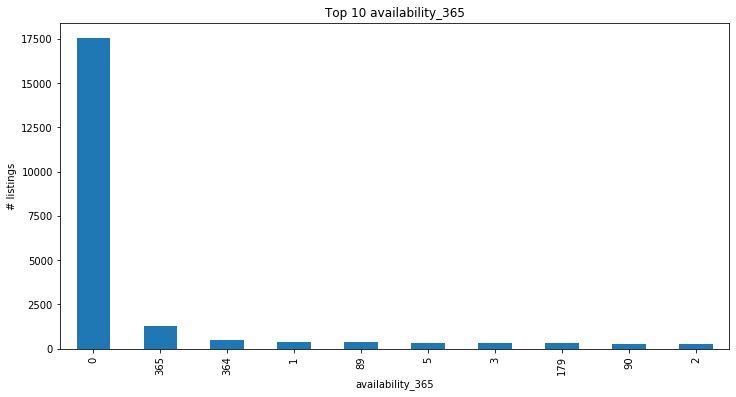

In [11]:
for col in df.columns:
    fig = plt.figure(figsize =(12,6))
    df_sub = df[col].astype(str).value_counts().head(10)
    df_sub.plot.bar(title=f"Top 10 {col}")
    plt.ylabel("# listings")
    plt.xlabel(col)

In [97]:
folium_map = folium.Map(location=[40.738, -73.98],
                        zoom_start=12,
                        tiles="CartoDB dark_matter")
marker = folium.CircleMarker(location=[40.738, -73.98])
marker.add_to(folium_map)

In [98]:
locations = df[["latitude", "longitude"]].values

In [99]:
for loc in locations:
    marker = folium.CircleMarker(location=loc)
    marker.add_to(folium_map)

In [100]:
folium_map

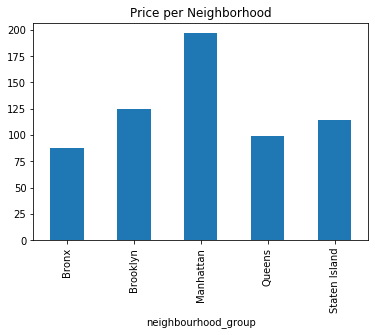

In [113]:
df.groupby(by=["neighbourhood_group"]).mean()["price"].plot.bar(title="Price per Neighborhood")

In [156]:
df.groupby(by=["neighbourhood_group"]).mean()

,host_id,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
neighbourhood_group,,,,,,,,,
Bronx,1.056099e+08,40.848305,-73.884552,87.496792,4.560953,26.004583,1.837831,2.233731,165.758937
Brooklyn,5.671526e+07,40.685036,-73.951190,124.383207,6.056556,24.202845,1.283212,2.284371,100.232292
Manhattan,6.783062e+07,40.765062,-73.974607,196.875814,8.579151,20.985596,1.272131,12.791330,111.979410
Queens,9.615680e+07,40.731531,-73.872775,99.517649,5.181433,27.700318,1.941200,4.060184,144.451818
Staten Island,9.853360e+07,40.610225,-74.105805,114.812332,4.831099,30.941019,1.872580,2.319035,199.678284


In [140]:
top_10_hosts = df.groupby(["host_id"]).count().sort_values(by="name", ascending=False).head(10).index.tolist()

In [148]:
df_top_hosts = df[df["host_id"].isin(top_10_hosts)].groupby("host_id").mean()
df_top_hosts

,latitude,longitude,price,minimum_nights,number_of_reviews,reviews_per_month,calculated_host_listings_count,availability_365
host_id,,,,,,,,
7503643,40.726098,-73.941170,149.192308,30.000000,4.653846,0.101224,52.0,297.711538
12243051,40.724568,-73.995714,213.031250,29.000000,0.447917,0.298276,96.0,276.614583
16098958,40.760237,-73.978597,208.958333,30.000000,1.437500,0.119672,96.0,292.322917
22541573,40.749462,-73.984605,215.436782,30.000000,0.632184,0.108974,87.0,312.172414
30283594,40.755483,-73.987668,277.528926,31.132231,0.537190,0.091628,121.0,313.421488
61391963,40.755541,-73.976226,146.241758,30.329670,4.582418,0.268101,91.0,241.923077
107434423,40.739673,-73.991947,303.150862,32.198276,0.125000,0.215714,232.0,253.810345
137358866,40.752971,-73.912234,43.825243,30.000000,0.844660,0.444706,103.0,196.475728
200380610,40.756832,-73.979005,290.230769,33.692308,0.015385,1.000000,65.0,338.030769


In [153]:
map_top_hosts = folium.Map(location=[40.738, -73.98],
                        zoom_start=12,
                        tiles="CartoDB dark_matter")
locs = df_top_hosts[["latitude", "longitude"]].values

In [154]:
for loc in locs:
    marker = folium.CircleMarker(location=loc)
    marker.add_to(map_top_hosts)

In [155]:
map_top_hosts